In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px

## Load Data

In [2]:
df = pd.read_csv(r"D:\Epsilon\Pandas & numpy\Mid Project\house_prices.csv", index_col= False)
df.head()

,Index,Title,Description,Amount(in rupees),Price (in rupees),location,Carpet Area,Status,Floor,Transaction,...,facing,overlooking,Society,Bathroom,Balcony,Car Parking,Ownership,Super Area,Dimensions,Plot Area
0,0,1 BHK Ready to Occupy Flat for sale in Srushti...,"Bhiwandi, Thane has an attractive 1 BHK Flat f...",42 Lac,6000.0,thane,500 sqft,Ready to Move,10 out of 11,Resale,...,NaN,NaN,Srushti Siddhi Mangal Murti Complex,1,2,NaN,NaN,NaN,NaN,NaN
1,1,2 BHK Ready to Occupy Flat for sale in Dosti V...,One can find this stunning 2 BHK flat for sale...,98 Lac,13799.0,thane,473 sqft,Ready to Move,3 out of 22,Resale,...,East,Garden/Park,Dosti Vihar,2,NaN,1 Open,Freehold,NaN,NaN,NaN
2,2,2 BHK Ready to Occupy Flat for sale in Sunrise...,Up for immediate sale is a 2 BHK apartment in ...,1.40 Cr,17500.0,thane,779 sqft,Ready to Move,10 out of 29,Resale,...,East,Garden/Park,Sunrise by Kalpataru,2,NaN,1 Covered,Freehold,NaN,NaN,NaN
3,3,1 BHK Ready to Occupy Flat for sale Kasheli,This beautiful 1 BHK Flat is available for sal...,25 Lac,NaN,thane,530 sqft,Ready to Move,1 out of 3,Resale,...,NaN,NaN,NaN,1,1,NaN,NaN,NaN,NaN,NaN
4,4,2 BHK Ready to Occupy Flat for sale in TenX Ha...,"This lovely 2 BHK Flat in Pokhran Road, Thane ...",1.60 Cr,18824.0,thane,635 sqft,Ready to Move,20 out of 42,Resale,...,West,"Garden/Park, Main Road",TenX Habitat Raymond Realty,2,NaN,1 Covered,Co-operative Society,NaN,NaN,NaN


In [3]:
df.shape

(187531, 21)

## Data Exploration

In [4]:
df.duplicated().sum()

np.int64(0)

In [5]:
df.describe()

,Index,Price (in rupees),Dimensions,Plot Area
count,187531.000000,1.698660e+05,0.0,0.0
mean,93765.000000,7.583772e+03,NaN,NaN
std,54135.681003,2.724171e+04,NaN,NaN
min,0.000000,0.000000e+00,NaN,NaN
25%,46882.500000,4.297000e+03,NaN,NaN
50%,93765.000000,6.034000e+03,NaN,NaN
75%,140647.500000,9.450000e+03,NaN,NaN
max,187530.000000,6.700000e+06,NaN,NaN


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 187531 entries, 0 to 187530
Data columns (total 21 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Index              187531 non-null  int64  
 1   Title              187531 non-null  object 
 2   Description        184508 non-null  object 
 3   Amount(in rupees)  187531 non-null  object 
 4   Price (in rupees)  169866 non-null  float64
 5   location           187531 non-null  object 
 6   Carpet Area        106858 non-null  object 
 7   Status             186916 non-null  object 
 8   Floor              180454 non-null  object 
 9   Transaction        187448 non-null  object 
 10  Furnishing         184634 non-null  object 
 11  facing             117298 non-null  object 
 12  overlooking        106095 non-null  object 
 13  Society            77853 non-null   object 
 14  Bathroom           186703 non-null  object 
 15  Balcony            138596 non-null  object 
 16  Ca

In [7]:
df.isna().sum()

Index                     0
Title                     0
Description            3023
Amount(in rupees)         0
Price (in rupees)     17665
location                  0
Carpet Area           80673
Status                  615
Floor                  7077
Transaction              83
Furnishing             2897
facing                70233
overlooking           81436
Society              109678
Bathroom                828
Balcony               48935
Car Parking          103357
Ownership             65517
Super Area           107685
Dimensions           187531
Plot Area            187531
dtype: int64

In [8]:
for each in df.columns:

    print(each, df[each].nunique())
    

Index 187531
Title 32446
Description 65634
Amount(in rupees) 1561
Price (in rupees) 10958
location 81
Carpet Area 2758
Status 1
Floor 947
Transaction 4
Furnishing 3
facing 8
overlooking 19
Society 10376
Bathroom 11
Balcony 11
Car Parking 229
Ownership 4
Super Area 2976
Dimensions 0
Plot Area 0


## Drop unnecessary columns

In [9]:
# these columns are either empty columns or columns with one unique value like Status
df.drop(columns=["Title","Description","Index","Dimensions","Plot Area", "Status"], inplace= True)
df.shape

(187531, 15)

In [10]:
df.duplicated().sum()

np.int64(120499)

In [11]:
df.drop_duplicates(inplace = True, ignore_index=True)
df.shape[0]

67032

In [12]:
df.columns

Index(['Amount(in rupees)', 'Price (in rupees)', 'location', 'Carpet Area',
       'Floor', 'Transaction', 'Furnishing', 'facing', 'overlooking',
       'Society', 'Bathroom', 'Balcony', 'Car Parking', 'Ownership',
       'Super Area'],
      dtype='object')

## Percantage of missing value in each column

In [13]:
low_mv = []   # List of Low missing value columns
medim_mv = []  # List of Medium missing value columns
high_mv = []   # List of2 High missing value columns

for each in df.columns:
    cal = (df[each].isna().sum()/df.shape[0])*100
    print(each , "\n")
    print(cal, "\n")
    print("***************************\n")
    if cal < 5:
        low_mv.append(each)
    elif 5 < cal < 40:
        medim_mv.append(each)
    else:
        high_mv.append(each)
print("low missing value columns  " ,low_mv,"\n medium missing value columns" ,medim_mv,
      "\n high missing value columns",high_mv)

Amount(in rupees) 

0.0 

***************************

Price (in rupees) 

8.703305883757013 

***************************

location 

0.0 

***************************

Carpet Area 

44.05358634681943 

***************************

Floor 

3.789234992242511 

***************************

Transaction 

0.1163623344074472 

***************************

Furnishing 

1.884174722520587 

***************************

facing 

39.35135457691848 

***************************

overlooking 

43.36734693877551 

***************************

Society 

57.06229860365198 

***************************

Bathroom 

0.6713211600429645 

***************************

Balcony 

27.87176274018379 

***************************

Car Parking 

57.902195966105744 

***************************

Ownership 

36.59744599594224 

***************************

Super Area 

56.13139992839241 

***************************

low missing value columns   ['Amount(in rupees)', 'location', 'Floor', 'Transaction', 'Furnishing

## Droping the high missing value columns

In [14]:
# removing the carpet area from the high missing value due it's importance
high_mv.pop(0)
high_mv

['overlooking', 'Society', 'Car Parking', 'Super Area']

In [15]:
df.drop(columns = high_mv, inplace = True)


In [16]:
df.shape

(67032, 11)

In [17]:
df.duplicated().sum()

np.int64(364)

# Drop the low missing value columns' row

In [18]:
df.dropna(subset=low_mv,axis = 0,inplace = True)
df = df.reset_index(drop = True)
df.tail(10)



,Amount(in rupees),Price (in rupees),location,Carpet Area,Floor,Transaction,Furnishing,facing,Bathroom,Balcony,Ownership
63478,1.18 Cr,5816.0,zirakpur,NaN,2 out of 11,Resale,Unfurnished,NaN,4,4,Freehold
63479,80 Lac,4040.0,zirakpur,1200 sqft,3 out of 3,Resale,Semi-Furnished,East,3,3,Freehold
63480,1.19 Cr,4547.0,zirakpur,1705 sqft,5 out of 10,Resale,Semi-Furnished,North - East,5,3,Freehold
63481,69.6 Lac,5135.0,zirakpur,895 sqft,5 out of 8,Resale,Semi-Furnished,North - East,3,2,Freehold
63482,44.9 Lac,3904.0,zirakpur,1050 sqft,1 out of 3,New Property,Unfurnished,North - East,3,2,Freehold
63483,63 Lac,3225.0,zirakpur,NaN,2 out of 4,New Property,Semi-Furnished,East,3,3,Freehold
63484,55 Lac,3274.0,zirakpur,NaN,4 out of 6,Resale,Unfurnished,North - East,3,NaN,NaN
63485,76 Lac,4343.0,zirakpur,1250 sqft,1 out of 3,Resale,Furnished,East,3,2,Freehold
63486,30 Lac,4231.0,zirakpur,NaN,2 out of 2,Resale,Semi-Furnished,NaN,2,NaN,NaN
63487,1.18 Cr,6162.0,zirakpur,NaN,5 out of 13,Resale,Semi-Furnished,North - East,4,4,Freehold


# Converting some columns to float

## 1-Converting "Amount" column from string to float

In [19]:
def convert (x):
    if "Lac" in x:
        return float(x.replace("Lac",""))*100000
    elif "Cr" in x: 
        return float(x.replace("Cr","")) * 10000000
    elif x == "Call for Price":
        return 0
    else:
        return x
        
df['Amount(in rupees)'] = df["Amount(in rupees)"].apply(convert)



In [20]:
def convert_p(x):
    if x == "unknown":
        return None
    else:
        return float(x)

In [21]:
df["Price (in rupees)"] = df["Price (in rupees)"].apply(convert_p)

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63488 entries, 0 to 63487
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Amount(in rupees)  63488 non-null  float64
 1   Price (in rupees)  58022 non-null  float64
 2   location           63488 non-null  object 
 3   Carpet Area        36876 non-null  object 
 4   Floor              63488 non-null  object 
 5   Transaction        63488 non-null  object 
 6   Furnishing         63488 non-null  object 
 7   facing             40118 non-null  object 
 8   Bathroom           63488 non-null  object 
 9   Balcony            47819 non-null  object 
 10  Ownership          41839 non-null  object 
dtypes: float64(2), object(9)
memory usage: 5.3+ MB


In [23]:
df.head(5)

,Amount(in rupees),Price (in rupees),location,Carpet Area,Floor,Transaction,Furnishing,facing,Bathroom,Balcony,Ownership
0,4200000.0,6000.0,thane,500 sqft,10 out of 11,Resale,Unfurnished,NaN,1,2,NaN
1,9800000.0,13799.0,thane,473 sqft,3 out of 22,Resale,Semi-Furnished,East,2,NaN,Freehold
2,14000000.0,17500.0,thane,779 sqft,10 out of 29,Resale,Unfurnished,East,2,NaN,Freehold
3,2500000.0,NaN,thane,530 sqft,1 out of 3,Resale,Unfurnished,NaN,1,1,NaN
4,16000000.0,18824.0,thane,635 sqft,20 out of 42,Resale,Unfurnished,West,2,NaN,Co-operative Society


In [24]:
# drop rows where amount is less 1 as it doesn't make any sense 
df.drop(df[df["Amount(in rupees)"] < 1].index, axis = 0, inplace= True)
df = df.reset_index(drop= True)
df.shape
df.tail(10)

,Amount(in rupees),Price (in rupees),location,Carpet Area,Floor,Transaction,Furnishing,facing,Bathroom,Balcony,Ownership
60799,11800000.0,5816.0,zirakpur,NaN,2 out of 11,Resale,Unfurnished,NaN,4,4,Freehold
60800,8000000.0,4040.0,zirakpur,1200 sqft,3 out of 3,Resale,Semi-Furnished,East,3,3,Freehold
60801,11900000.0,4547.0,zirakpur,1705 sqft,5 out of 10,Resale,Semi-Furnished,North - East,5,3,Freehold
60802,6960000.0,5135.0,zirakpur,895 sqft,5 out of 8,Resale,Semi-Furnished,North - East,3,2,Freehold
60803,4490000.0,3904.0,zirakpur,1050 sqft,1 out of 3,New Property,Unfurnished,North - East,3,2,Freehold
60804,6300000.0,3225.0,zirakpur,NaN,2 out of 4,New Property,Semi-Furnished,East,3,3,Freehold
60805,5500000.0,3274.0,zirakpur,NaN,4 out of 6,Resale,Unfurnished,North - East,3,NaN,NaN
60806,7600000.0,4343.0,zirakpur,1250 sqft,1 out of 3,Resale,Furnished,East,3,2,Freehold
60807,3000000.0,4231.0,zirakpur,NaN,2 out of 2,Resale,Semi-Furnished,NaN,2,NaN,NaN
60808,11800000.0,6162.0,zirakpur,NaN,5 out of 13,Resale,Semi-Furnished,North - East,4,4,Freehold


## 2-Convert "Carpet Area" from object to float

In [25]:
def CarpetArea (x):
    if type(x) == float:
        return (x)
    elif "sqft" in x:
        return float(x.replace("sqft",""))
        
    

df["Carpet Area"]=df["Carpet Area"].apply(CarpetArea)


    


In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60809 entries, 0 to 60808
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Amount(in rupees)  60809 non-null  float64
 1   Price (in rupees)  58022 non-null  float64
 2   location           60809 non-null  object 
 3   Carpet Area        34052 non-null  float64
 4   Floor              60809 non-null  object 
 5   Transaction        60809 non-null  object 
 6   Furnishing         60809 non-null  object 
 7   facing             38904 non-null  object 
 8   Bathroom           60809 non-null  object 
 9   Balcony            46078 non-null  object 
 10  Ownership          40524 non-null  object 
dtypes: float64(3), object(8)
memory usage: 5.1+ MB


In [27]:
(df["Carpet Area"].isna().sum()/df.shape[0])*100

np.float64(44.00171027315036)

In [28]:
df["Bathroom"].value_counts()

Bathroom
2       31200
3       17562
1        6095
4        4520
5        1188
6         168
7          27
> 10       24
8          10
10          8
9           7
Name: count, dtype: int64

In [29]:
df["Balcony"].value_counts()

Balcony
2       17668
1       14849
3        9485
4        3236
5         675
6         114
7          13
8          13
10         12
> 10       11
9           2
Name: count, dtype: int64

## 3- Convert "Bathroom" to Float

In [30]:
def Bathroom(x):
    if type(x) == float:
        return x
    elif x == "> 10":
        return 10.1
    else:
        return int(x)
df["Bathroom"] = df["Bathroom"].apply(Bathroom)

## 4- Convert Balcony to float

In [31]:
def Bal(x):
    if type(x) == float:
        return x
    elif x == "> 10":
        return 10.1
    else:
        return int(x)
    
df["Balcony"] = df["Balcony"].apply(Bal)

# Feature Engineering

In [32]:
def floorno(x):
    x = x.split()
    
    if x[0] == "Ground":
        return (0)
    elif x[0] == "Upper":
        return (-1)
    elif x[0] == "Lower":
        return (-2)
    else:
        return int(x[0])
    
df["Floor No"] = df.Floor.apply(floorno)


In [33]:
def Building_no_of_floors(x):
    x = x.split()
    if len(x) == 1:
        return (None)
    else:
        return int(x[-1])
    
df["Total Floors"] = df.Floor.apply(Building_no_of_floors)


In [34]:
# now i can drop floor column
df = df.drop("Floor", axis=1).reset_index(drop = True)
df = df.reset_index(drop = True)
df.tail()

,Amount(in rupees),Price (in rupees),location,Carpet Area,Transaction,Furnishing,facing,Bathroom,Balcony,Ownership,Floor No,Total Floors
60804,6300000.0,3225.0,zirakpur,NaN,New Property,Semi-Furnished,East,3.0,3.0,Freehold,2,4.0
60805,5500000.0,3274.0,zirakpur,NaN,Resale,Unfurnished,North - East,3.0,NaN,NaN,4,6.0
60806,7600000.0,4343.0,zirakpur,1250.0,Resale,Furnished,East,3.0,2.0,Freehold,1,3.0
60807,3000000.0,4231.0,zirakpur,NaN,Resale,Semi-Furnished,NaN,2.0,NaN,NaN,2,2.0
60808,11800000.0,6162.0,zirakpur,NaN,Resale,Semi-Furnished,North - East,4.0,4.0,Freehold,5,13.0


In [35]:
df.duplicated().sum()

np.int64(188)

In [36]:
df.drop_duplicates(inplace= True, ignore_index= True)

In [37]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60621 entries, 0 to 60620
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Amount(in rupees)  60621 non-null  float64
 1   Price (in rupees)  57837 non-null  float64
 2   location           60621 non-null  object 
 3   Carpet Area        33927 non-null  float64
 4   Transaction        60621 non-null  object 
 5   Furnishing         60621 non-null  object 
 6   facing             38738 non-null  object 
 7   Bathroom           60621 non-null  float64
 8   Balcony            45903 non-null  float64
 9   Ownership          40353 non-null  object 
 10  Floor No           60621 non-null  int64  
 11  Total Floors       60582 non-null  float64
dtypes: float64(6), int64(1), object(5)
memory usage: 5.6+ MB


In [38]:
for each in df.columns:
    px.histogram(df, x = each, title= each).show()

In [39]:
df.head()

,Amount(in rupees),Price (in rupees),location,Carpet Area,Transaction,Furnishing,facing,Bathroom,Balcony,Ownership,Floor No,Total Floors
0,4200000.0,6000.0,thane,500.0,Resale,Unfurnished,NaN,1.0,2.0,NaN,10,11.0
1,9800000.0,13799.0,thane,473.0,Resale,Semi-Furnished,East,2.0,NaN,Freehold,3,22.0
2,14000000.0,17500.0,thane,779.0,Resale,Unfurnished,East,2.0,NaN,Freehold,10,29.0
3,2500000.0,NaN,thane,530.0,Resale,Unfurnished,NaN,1.0,1.0,NaN,1,3.0
4,16000000.0,18824.0,thane,635.0,Resale,Unfurnished,West,2.0,NaN,Co-operative Society,20,42.0


## Handle Outliers

In [40]:
dfA = df

In [41]:
def detect_OL(dataframe, column, lower_thershold, upper_thershold):
    lowerFence = dataframe[column].quantile(lower_thershold)
    upperFence = dataframe[column].quantile(upper_thershold)
    outlier_indices = dataframe[(dataframe[column] >upperFence) | (dataframe[column] < lowerFence)][column].index
    return outlier_indices

In [42]:
Amount_outliers = detect_OL(df,"Amount(in rupees)", 0.01,0.99)
Amount_outliers

Index([   49,   316,   469,   511,   780,   807,   872,  1219,  1487,  1501,
       ...
       56862, 56933, 57252, 57796, 58438, 58949, 59180, 59184, 59436, 60362],
      dtype='int64', length=1169)

In [43]:
dfA.drop(Amount_outliers, axis = 0, inplace= True)
dfA.head(3)

,Amount(in rupees),Price (in rupees),location,Carpet Area,Transaction,Furnishing,facing,Bathroom,Balcony,Ownership,Floor No,Total Floors
0,4200000.0,6000.0,thane,500.0,Resale,Unfurnished,NaN,1.0,2.0,NaN,10,11.0
1,9800000.0,13799.0,thane,473.0,Resale,Semi-Furnished,East,2.0,NaN,Freehold,3,22.0
2,14000000.0,17500.0,thane,779.0,Resale,Unfurnished,East,2.0,NaN,Freehold,10,29.0


In [44]:
px.box(dfA, y= "Amount(in rupees)", color_discrete_sequence=["red"])

In [45]:
area_outliers = detect_OL(df, "Carpet Area", 0.01,0.99)
area_outliers

Index([   25,   315,   317,   323,   448,   497,   662,   715,   747,   795,
       ...
       59072, 59079, 59152, 59169, 59383, 59883, 60198, 60487, 60562, 60583],
      dtype='int64', length=662)

In [46]:
dfA.drop(area_outliers, axis = 0, inplace = True)

In [47]:
px.box(dfA, y= "Carpet Area", color_discrete_sequence=["red"])

# Data Analysis

In [48]:
dfA.head(5)

,Amount(in rupees),Price (in rupees),location,Carpet Area,Transaction,Furnishing,facing,Bathroom,Balcony,Ownership,Floor No,Total Floors
0,4200000.0,6000.0,thane,500.0,Resale,Unfurnished,NaN,1.0,2.0,NaN,10,11.0
1,9800000.0,13799.0,thane,473.0,Resale,Semi-Furnished,East,2.0,NaN,Freehold,3,22.0
2,14000000.0,17500.0,thane,779.0,Resale,Unfurnished,East,2.0,NaN,Freehold,10,29.0
3,2500000.0,NaN,thane,530.0,Resale,Unfurnished,NaN,1.0,1.0,NaN,1,3.0
4,16000000.0,18824.0,thane,635.0,Resale,Unfurnished,West,2.0,NaN,Co-operative Society,20,42.0


## What is the average price for each location?

In [49]:
df1 = dfA.groupby("location")["Amount(in rupees)"].mean().sort_values(ascending= False)
re = px.bar(df1 , color_discrete_sequence=["red"])
re.show()

## Relation between area and price

<Axes: xlabel='Carpet Area', ylabel='Amount(in rupees)'>

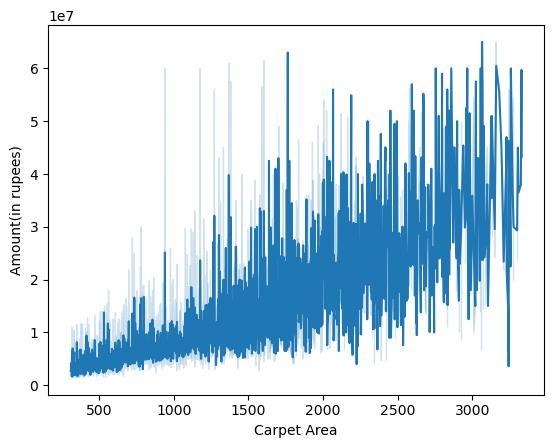

In [50]:
df2 = dfA.groupby("Carpet Area")["Amount(in rupees)"].max().sort_values(ascending= True)
df2
sns.lineplot(x = "Carpet Area", y = "Amount(in rupees)", data = df)
#sns.lineplot(df2)



In [51]:
px.scatter( dfA["Amount(in rupees)"],dfA["Carpet Area"])

In [52]:
dfA["Carpet Area"].unique()

array([ 500.,  473.,  779., ..., 2340., 1526., 1634.], shape=(1966,))

In [53]:
px.bar(dfA, x = "Carpet Area",y = "Amount(in rupees)", 
       
       color_discrete_sequence= ["red"])


## Does the number of bathrooms affect the price?

<Axes: xlabel='Bathroom', ylabel='Amount(in rupees)'>

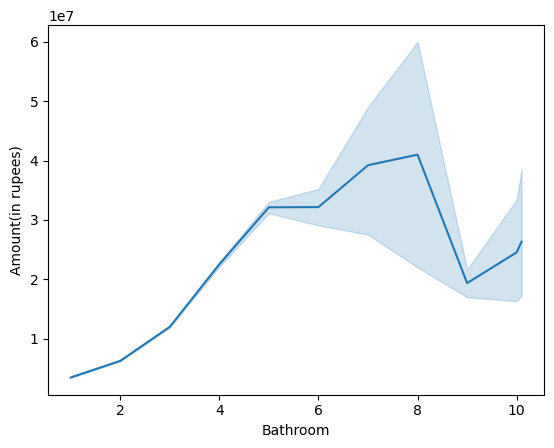

In [54]:
df3 = dfA.groupby("Bathroom")["Amount(in rupees)"].median().sort_values(ascending= True)

sns.lineplot(x = "Bathroom", y = "Amount(in rupees)", data = dfA)


## Does the number of balcony affect the price

<Axes: xlabel='Balcony', ylabel='Amount(in rupees)'>

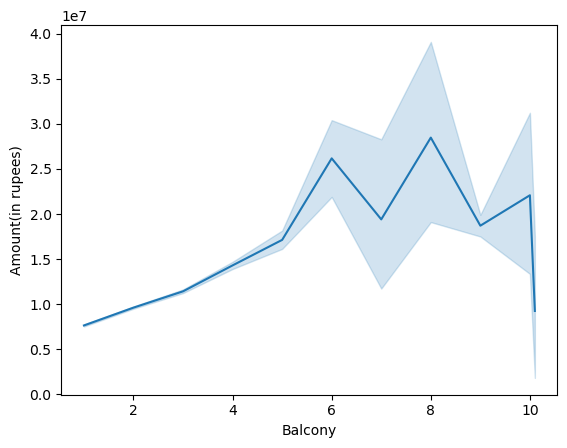

In [55]:
df4 = dfA.groupby("Balcony")["Amount(in rupees)"].median().sort_values(ascending= True)

sns.lineplot(x = "Balcony", y = "Amount(in rupees)", data = dfA)

In [56]:
dfA["Ownership"].nunique()

4

## Ownership perentage

In [57]:
px.pie(dfA, names= "Ownership")

## Does th ownership affect the price

<Axes: xlabel='Ownership', ylabel='Amount(in rupees)'>

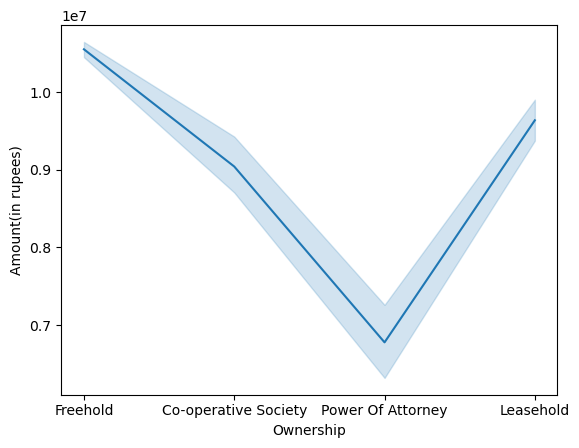

In [58]:
df4 = dfA.groupby("Ownership")["Amount(in rupees)"].count().sort_values()

sns.lineplot(x = "Ownership", y = "Amount(in rupees)", data = dfA)

In [59]:
dfA["facing"].nunique()
px.pie(dfA, names = "facing")

## Does Facing affect price?

In [60]:
px.bar(dfA, x = "facing",y = "Amount(in rupees)", 
       
       color_discrete_sequence= ["red"])

In [61]:
dfA["Transaction"].nunique()
px.pie(dfA, names = "Transaction")

## Relation between Transaction and Price

In [62]:
px.bar(dfA, x = "Transaction",y = "Amount(in rupees)", 
       title = "Relation between Transaction and price",
       labels = {"Transaction":"Price"},
       color_discrete_sequence= ["red"])

## Does the floor number affect price?

<Axes: xlabel='Floor No', ylabel='Amount(in rupees)'>

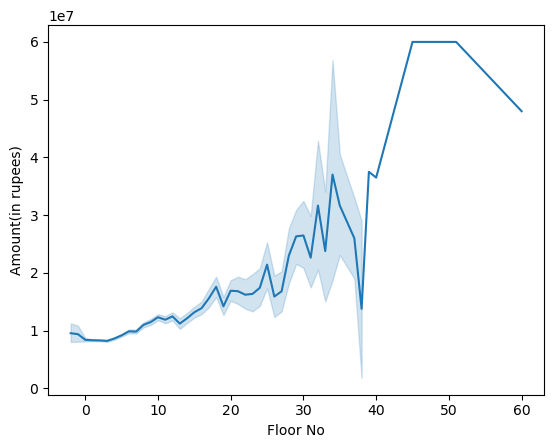

In [63]:
sns.lineplot(x = "Floor No", y = "Amount(in rupees)", data = dfA)

In [64]:
df5 = dfA.groupby(["Carpet Area","location"])["Amount(in rupees)"].max().sort_values(ascending= True)
dfA[dfA["Carpet Area"] == dfA["Carpet Area"].max()]["location"]


42082    jamshedpur
Name: location, dtype: object

In [65]:
dfA["location"].nunique()

81

## Does the Furnishing affect price?

In [66]:
dfx = dfA.groupby("Furnishing")["Amount(in rupees)"].median().sort_values()

px.bar(dfx, color_discrete_sequence=["red"])


## The cost of maximum area in each city

In [67]:
df6 = dfA.groupby("location")["Carpet Area"].idxmax().sort_values(ascending=False)
df6
df.loc[df6, ["location", "Carpet Area", "Amount(in rupees)"]]

,location,Carpet Area,Amount(in rupees)
60207,zirakpur,3060.0,6700000.0
59208,vrindavan,1300.0,13000000.0
58909,visakhapatnam,3300.0,23100000.0
57220,vijayawada,3300.0,20000000.0
56818,varanasi,2450.0,8000000.0
...,...,...,...
3761,ahmedabad,3270.0,54500000.0
2317,mumbai,3200.0,61100000.0
1349,nagpur,2300.0,25100000.0
918,navi-mumbai,2043.0,42500000.0


In [68]:
dfA[dfA["Amount(in rupees)"] == dfA['Amount(in rupees)'].max()]
dfA[dfA["Floor No"] == -1]
new = dfA.groupby(["Floor No","facing"])["Amount(in rupees)"].mean().sort_values().reset_index()
new

,Floor No,facing,Amount(in rupees)
0,-2,South - East,3300000.0
1,26,North - West,5160000.0
2,32,North - West,5500000.0
3,19,South -West,5600000.0
4,-2,South,5672500.0
...,...,...,...
269,32,West,57000000.0
270,51,East,60000000.0
271,23,South,60000000.0
272,45,South - East,60000000.0


In [69]:
px.box(data_frame= dfA, x= 'Furnishing', y= 'Amount(in rupees)', color_discrete_sequence=['red'])

In [70]:
dfA[dfA["Ownership"]=="Leasehold"]

,Amount(in rupees),Price (in rupees),location,Carpet Area,Transaction,Furnishing,facing,Bathroom,Balcony,Ownership,Floor No,Total Floors
149,6000000.0,7143.0,thane,NaN,Resale,Semi-Furnished,South,1.0,NaN,Leasehold,5,6.0
195,3600000.0,NaN,thane,510.0,New Property,Semi-Furnished,NaN,1.0,1.0,Leasehold,11,18.0
249,3000000.0,4478.0,thane,475.0,Resale,Furnished,East,1.0,2.0,Leasehold,2,4.0
413,9500000.0,18591.0,thane,NaN,Resale,Furnished,East,1.0,NaN,Leasehold,7,15.0
832,5500000.0,6875.0,thane,600.0,Resale,Unfurnished,North - East,2.0,NaN,Leasehold,2,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...
58583,15000000.0,8000.0,visakhapatnam,1875.0,Resale,Semi-Furnished,North,3.0,2.0,Leasehold,4,5.0
58610,5290000.0,4069.0,visakhapatnam,1300.0,Resale,Unfurnished,South,2.0,2.0,Leasehold,5,5.0
59292,7200000.0,3945.0,zirakpur,NaN,Resale,Semi-Furnished,North - East,3.0,NaN,Leasehold,11,13.0
59694,5500000.0,4701.0,zirakpur,NaN,Resale,Unfurnished,North - East,4.0,3.0,Leasehold,6,6.0


# Save Cleaned data

In [71]:
dfA.to_csv("House_Pricing_Cleaned_1")

In [72]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 58790 entries, 0 to 60620
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Amount(in rupees)  58790 non-null  float64
 1   Price (in rupees)  56115 non-null  float64
 2   location           58790 non-null  object 
 3   Carpet Area        32698 non-null  float64
 4   Transaction        58790 non-null  object 
 5   Furnishing         58790 non-null  object 
 6   facing             37556 non-null  object 
 7   Bathroom           58790 non-null  float64
 8   Balcony            44540 non-null  float64
 9   Ownership          39113 non-null  object 
 10  Floor No           58790 non-null  int64  
 11  Total Floors       58751 non-null  float64
dtypes: float64(6), int64(1), object(5)
memory usage: 7.8+ MB


# Data preprocessing

In [73]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 58790 entries, 0 to 60620
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Amount(in rupees)  58790 non-null  float64
 1   Price (in rupees)  56115 non-null  float64
 2   location           58790 non-null  object 
 3   Carpet Area        32698 non-null  float64
 4   Transaction        58790 non-null  object 
 5   Furnishing         58790 non-null  object 
 6   facing             37556 non-null  object 
 7   Bathroom           58790 non-null  float64
 8   Balcony            44540 non-null  float64
 9   Ownership          39113 non-null  object 
 10  Floor No           58790 non-null  int64  
 11  Total Floors       58751 non-null  float64
dtypes: float64(6), int64(1), object(5)
memory usage: 7.8+ MB


## Handling Missing values

In [74]:
df.isna().sum()

Amount(in rupees)        0
Price (in rupees)     2675
location                 0
Carpet Area          26092
Transaction              0
Furnishing               0
facing               21234
Bathroom                 0
Balcony              14250
Ownership            19677
Floor No                 0
Total Floors            39
dtype: int64

In [75]:
df.shape[0]

58790

In [76]:

df["Ownership"] = df["Ownership"].fillna("unknown")

In [77]:
df.isna().sum()

Amount(in rupees)        0
Price (in rupees)     2675
location                 0
Carpet Area          26092
Transaction              0
Furnishing               0
facing               21234
Bathroom                 0
Balcony              14250
Ownership                0
Floor No                 0
Total Floors            39
dtype: int64

In [78]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 58790 entries, 0 to 60620
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Amount(in rupees)  58790 non-null  float64
 1   Price (in rupees)  56115 non-null  float64
 2   location           58790 non-null  object 
 3   Carpet Area        32698 non-null  float64
 4   Transaction        58790 non-null  object 
 5   Furnishing         58790 non-null  object 
 6   facing             37556 non-null  object 
 7   Bathroom           58790 non-null  float64
 8   Balcony            44540 non-null  float64
 9   Ownership          58790 non-null  object 
 10  Floor No           58790 non-null  int64  
 11  Total Floors       58751 non-null  float64
dtypes: float64(6), int64(1), object(5)
memory usage: 7.8+ MB


In [79]:
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy="median")
df["Carpet Area"] = imputer.fit_transform(df[["Carpet Area"]])
df["Balcony"] = imputer.fit_transform(df[["Balcony"]])

imputer1 = SimpleImputer(strategy = "most_frequent")
imputed_values = imputer1.fit_transform(df["facing"].values.reshape(-1,1))
df["facing"] = imputed_values.reshape(-1)
df["facing"].isna().sum()



np.int64(0)

In [80]:
df.isna().sum()

Amount(in rupees)       0
Price (in rupees)    2675
location                0
Carpet Area             0
Transaction             0
Furnishing              0
facing                  0
Bathroom                0
Balcony                 0
Ownership               0
Floor No                0
Total Floors           39
dtype: int64

In [81]:
imputer2 = SimpleImputer(strategy= "median")
df["Total Floors"] = imputer2.fit_transform(df[["Total Floors"]])

In [82]:
df.isna().sum()

Amount(in rupees)       0
Price (in rupees)    2675
location                0
Carpet Area             0
Transaction             0
Furnishing              0
facing                  0
Bathroom                0
Balcony                 0
Ownership               0
Floor No                0
Total Floors            0
dtype: int64

In [83]:
from sklearn.impute import KNNImputer

knn = KNNImputer(n_neighbors=5)
df["Price (in rupees)"]=knn.fit_transform(df[["Price (in rupees)"]])

In [84]:
df["Price (in rupees)"]
px.histogram(df, x = "Price (in rupees)")

In [85]:
df.shape

(58790, 12)

## Handling outliers

In [86]:
px.box(df, y= "Amount(in rupees)", color_discrete_sequence=["red"])

In [87]:
from datasist.structdata import detect_outliers

outliers = detect_outliers(df, n = 0,features=["Amount(in rupees)"])
price_median = df["Amount(in rupees)"].median()
#df.loc[outliers,"Amount(in rupees)"] = price_median


In [88]:
def detect_OL(dataframe, column, lower_thershold, upper_thershold):
    lowerFence = dataframe[column].quantile(lower_thershold)
    upperFence = dataframe[column].quantile(upper_thershold)
    outlier_indices = dataframe[(dataframe[column] >upperFence) | (dataframe[column] < lowerFence)][column].index
    return outlier_indices

In [89]:
from sklearn.preprocessing import RobustScaler

scalar = RobustScaler()
df["Amount(in rupees)"] = scalar.fit_transform(df[["Amount(in rupees)"]])

In [90]:
px.box(df, y= "Amount(in rupees)", color_discrete_sequence=["red"]).show()

## Drop the outliers in the Amount column

In [91]:
Amount_outliers = detect_OL(df,"Amount(in rupees)", 0.01,0.99)
Amount_outliers

Index([  111,   136,   145,   233,   248,   294,   554,   609,   615,   685,
       ...
       56930, 57019, 58648, 59160, 59251, 59272, 59372, 59373, 59374, 59375],
      dtype='int64', length=1044)

In [92]:
#df.drop(Amount_outliers, axis = 0, inplace= True)

In [93]:
#px.box(df, y= "Amount(in rupees)", color_discrete_sequence=["red"]).show()

## Carpet Area outliers

In [94]:
px.box(df, y= "Carpet Area")

## Area outliers

In [95]:
from sklearn.preprocessing import RobustScaler
scalar1 = RobustScaler()
df["Carpet Area"]=scalar1.fit_transform(df[["Carpet Area"]])

In [96]:
px.box(df, y= "Carpet Area")

In [97]:
# area_outliers = detect_OL(df, "Carpet Area", 0.01,0.99)
# area_outliers

In [98]:
# df.drop(area_outliers, axis = 0, inplace = True)


In [99]:
# px.box(df, y= "Carpet Area")

In [100]:
df.shape

(58790, 12)

# Check Categorical Columns in Details

In [101]:
cat_CL= df.select_dtypes(include="object").columns

In [102]:
for col in cat_CL:
    print(col,"\n")
    print(df[col].nunique(),"\n")
    print(df[col].unique(),"\n")
    print("***************")

location 

81 

['thane' 'navi-mumbai' 'nagpur' 'mumbai' 'ahmedabad' 'bangalore' 'chennai'
 'gurgaon' 'hyderabad' 'indore' 'jaipur' 'kolkata' 'lucknow' 'new-delhi'
 'noida' 'pune' 'agra' 'ahmadnagar' 'allahabad' 'aurangabad' 'badlapur'
 'belgaum' 'bhiwadi' 'bhiwandi' 'bhopal' 'bhubaneswar' 'chandigarh'
 'coimbatore' 'dehradun' 'durgapur' 'ernakulam' 'faridabad' 'ghaziabad'
 'goa' 'greater-noida' 'guntur' 'guwahati' 'gwalior' 'haridwar' 'jabalpur'
 'jamshedpur' 'jodhpur' 'kalyan' 'kanpur' 'kochi' 'kozhikode' 'ludhiana'
 'madurai' 'mangalore' 'mohali' 'mysore' 'nashik' 'navsari' 'nellore'
 'palakkad' 'palghar' 'panchkula' 'patna' 'pondicherry' 'raipur'
 'rajahmundry' 'ranchi' 'satara' 'shimla' 'siliguri' 'solapur' 'sonipat'
 'surat' 'thrissur' 'tirupati' 'trichy' 'trivandrum' 'udaipur' 'udupi'
 'vadodara' 'vapi' 'varanasi' 'vijayawada' 'visakhapatnam' 'vrindavan'
 'zirakpur'] 

***************
Transaction 

4 

['Resale' 'New Property' 'Other' 'Rent/Lease'] 

***************
Furnishing 


In [103]:
df_nominal = df.select_dtypes(include= 'object').drop(["Title","Description","location"],axis = 1)
df_nominal
df_E = df[["location"]]
df_E

KeyError: "['Title', 'Description'] not found in axis"

In [ ]:
from sklearn.preprocessing import OneHotEncoder

oneHE = OneHotEncoder(drop = "first", sparse_output= False)
one_arr = oneHE.fit_transform(df_nominal)

one_arr


array([[0., 0., 1., ..., 0., 0., 1.],
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 1.],
       [0., 0., 1., ..., 0., 0., 0.]], shape=(58350, 16))

In [ ]:
one_df= pd.DataFrame(one_arr, columns=oneHE.get_feature_names_out())
one_df

,Transaction_Other,Transaction_Rent/Lease,Transaction_Resale,Furnishing_Semi-Furnished,Furnishing_Unfurnished,facing_North,facing_North - East,facing_North - West,facing_South,facing_South - East,facing_South -West,facing_West,Ownership_Freehold,Ownership_Leasehold,Ownership_Power Of Attorney,Ownership_unknown
0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58345,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
58346,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
58347,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
58348,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [ ]:
from category_encoders import BinaryEncoder

be = BinaryEncoder()

be_df = be.fit_transform(df_E)
be_df

,location_0,location_1,location_2,location_3,location_4,location_5,location_6
0,0,0,0,0,0,0,1
1,0,0,0,0,0,0,1
2,0,0,0,0,0,0,1
3,0,0,0,0,0,0,1
4,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...
60162,1,0,1,0,0,0,1
60163,1,0,1,0,0,0,1
60164,1,0,1,0,0,0,1
60165,1,0,1,0,0,0,1


In [ ]:
df = pd.concat([df, one_df]).drop(df_nominal,axis=1)
df.head()

,Title,Description,Amount(in rupees),Price (in rupees),location,Carpet Area,Bathroom,Balcony,Floor No,Total Floors,...,facing_North - East,facing_North - West,facing_South,facing_South - East,facing_South -West,facing_West,Ownership_Freehold,Ownership_Leasehold,Ownership_Power Of Attorney,Ownership_unknown
0,1 BHK Ready to Occupy Flat for sale in Srushti...,"Bhiwandi, Thane has an attractive 1 BHK Flat f...",-0.365079,6000.000000,thane,-4.285714,1.0,2.0,10.0,11.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2 BHK Ready to Occupy Flat for sale in Dosti V...,One can find this stunning 2 BHK flat for sale...,0.523810,13799.000000,thane,-4.478571,2.0,2.0,3.0,22.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2 BHK Ready to Occupy Flat for sale in Sunrise...,Up for immediate sale is a 2 BHK apartment in ...,1.190476,17500.000000,thane,-2.292857,2.0,2.0,10.0,29.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1 BHK Ready to Occupy Flat for sale Kasheli,This beautiful 1 BHK Flat is available for sal...,-0.634921,6360.061545,thane,-4.071429,1.0,1.0,1.0,3.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2 BHK Ready to Occupy Flat for sale in TenX Ha...,"This lovely 2 BHK Flat in Pokhran Road, Thane ...",1.507937,18824.000000,thane,-3.321429,2.0,2.0,20.0,42.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df = pd.concat([df,be_df]).drop(["location","Title","Description"],axis = 1)
df.head()

,Amount(in rupees),Price (in rupees),Carpet Area,Bathroom,Balcony,Floor No,Total Floors,Transaction_Other,Transaction_Rent/Lease,Transaction_Resale,...,Ownership_Leasehold,Ownership_Power Of Attorney,Ownership_unknown,location_0,location_1,location_2,location_3,location_4,location_5,location_6
0,-0.365079,6000.000000,-4.285714,1.0,2.0,10.0,11.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.523810,13799.000000,-4.478571,2.0,2.0,3.0,22.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.190476,17500.000000,-2.292857,2.0,2.0,10.0,29.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,-0.634921,6360.061545,-4.071429,1.0,1.0,1.0,3.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1.507937,18824.000000,-3.321429,2.0,2.0,20.0,42.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
import pipreqs
! pipreqs